In [ ]:
# Step 1: Install necessary libraries
!pip install ultralytics  # Install YOLOv8
!pip install matplotlib opencv-python-headless
!pip install roboflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 906.9/906.9 kB 46.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.5/81.5 kB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.6 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10


In [ ]:
# Step 2: Import libraries
import matplotlib.pyplot as plt
from ultralytics import YOLO
from google.colab import files
import cv2
import numpy as np

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="p9AE4cfyWZVtKr7MenmF")
project = rf.workspace("database-alaik").project("orang-elbgh")
version = project.version(1)
dataset = version.download("yolov8")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to orang-1 in yolov8:: 100%|██████████| 162/162 [00:00<00:00, 5150.44it/s]


In [ ]:
import os

# Lihat folder tempat dataset diunduh
dataset_location = dataset.location  # dari RoboFlow download
print("Dataset downloaded to:", dataset_location)

Dataset downloaded to: /content/orang-1


In [ ]:
from ultralytics import YOLO

# Buat model YOLOv8 baru
model = YOLO("yolov8n.pt")  # "yolov8n.pt" adalah versi YOLOv8 Nano

# Jalankan pelatihan dengan dataset
model.train(data="/content/orang-1/data.yaml", epochs=75, imgsz=640)

100%|██████████| 6.25M/6.25M [00:00<00:00, 148MB/s]


Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/orang-1/data.yaml, epochs=75, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=Tr

100%|██████████| 755k/755k [00:00<00:00, 70.4MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /content/orang-1/train/labels... 53 images, 0 backgrounds, 0 corrupt: 100%|██████████| 53/53 [00:00<00:00, 770.06it/s]

train: New cache created: /content/orang-1/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


A new version of Albumentations is available: 2.0.0 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
val: Scanning /content/orang-1/valid/labels... 15 images, 0 backgrounds, 0 corrupt: 100%|██████████| 15/15 [00:00<00:00, 1789.12it/s]

val: New cache created: /content/orang-1/valid/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train
Starting training for 75 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/75         0G      2.001       2.73      1.823         25        640: 100%|██████████| 4/4 [00:51<00:00, 12.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:05<00:00,  5.20s/it]

                   all         15         58      0.012      0.931      0.685      0.292



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/75         0G      1.787      2.434       1.56         37        640: 100%|██████████| 4/4 [00:43<00:00, 10.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.77s/it]

                   all         15         58     0.0124      0.966      0.763      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/75         0G      1.582      1.745      1.421         18        640: 100%|██████████| 4/4 [00:42<00:00, 10.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.37s/it]

                   all         15         58          1      0.382      0.735      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/75         0G      1.686      1.548      1.421         42        640: 100%|██████████| 4/4 [00:44<00:00, 11.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.70s/it]

                   all         15         58       0.97      0.556      0.791      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/75         0G      1.694      1.587      1.488         37        640: 100%|██████████| 4/4 [00:42<00:00, 10.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:05<00:00,  5.07s/it]

                   all         15         58      0.969      0.534       0.78      0.318



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/75         0G      1.559      1.423      1.395         31        640: 100%|██████████| 4/4 [00:41<00:00, 10.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.70s/it]

                   all         15         58      0.968      0.672       0.79      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/75         0G      1.507      1.364      1.343         32        640: 100%|██████████| 4/4 [00:42<00:00, 10.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.59s/it]

                   all         15         58      0.934      0.735      0.795      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/75         0G       1.53      1.271      1.322         37        640: 100%|██████████| 4/4 [00:40<00:00, 10.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:05<00:00,  5.01s/it]

                   all         15         58      0.905      0.724      0.788      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/75         0G      1.527      1.308      1.353         34        640: 100%|██████████| 4/4 [00:42<00:00, 10.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.90s/it]

                   all         15         58      0.878      0.741      0.785      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/75         0G      1.472      1.278      1.314         38        640: 100%|██████████| 4/4 [00:41<00:00, 10.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.61s/it]

                   all         15         58      0.892      0.715      0.773      0.337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/75         0G      1.474      1.313      1.329         30        640: 100%|██████████| 4/4 [00:40<00:00, 10.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:05<00:00,  5.01s/it]

                   all         15         58       0.85      0.685      0.741      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/75         0G      1.487      1.278      1.315         36        640: 100%|██████████| 4/4 [00:41<00:00, 10.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.63s/it]

                   all         15         58      0.809      0.638      0.662      0.269



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/75         0G      1.396      1.234      1.323         30        640: 100%|██████████| 4/4 [00:41<00:00, 10.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.62s/it]

                   all         15         58      0.745      0.621      0.654      0.279



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/75         0G      1.512      1.266      1.371         44        640: 100%|██████████| 4/4 [00:41<00:00, 10.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.95s/it]

                   all         15         58       0.82       0.63      0.697      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/75         0G      1.459      1.264      1.355         46        640: 100%|██████████| 4/4 [00:41<00:00, 10.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.61s/it]

                   all         15         58      0.825       0.65      0.701      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/75         0G      1.455      1.237      1.309         33        640: 100%|██████████| 4/4 [00:42<00:00, 10.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.64s/it]

                   all         15         58       0.69      0.638      0.648      0.259



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/75         0G      1.398      1.224      1.298         20        640: 100%|██████████| 4/4 [00:40<00:00, 10.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.91s/it]

                   all         15         58      0.672      0.603      0.572      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/75         0G       1.49       1.27      1.357         21        640: 100%|██████████| 4/4 [00:40<00:00, 10.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.79s/it]

                   all         15         58      0.673      0.466      0.481      0.151



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/75         0G      1.539      1.289       1.35         25        640: 100%|██████████| 4/4 [00:41<00:00, 10.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.62s/it]

                   all         15         58      0.727      0.505      0.593      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/75         0G      1.482      1.293      1.376         14        640: 100%|██████████| 4/4 [00:41<00:00, 10.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.35s/it]

                   all         15         58      0.798      0.552       0.63      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/75         0G      1.445      1.218      1.349         31        640: 100%|██████████| 4/4 [00:39<00:00,  9.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.73s/it]

                   all         15         58      0.762      0.466      0.604      0.239



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/75         0G      1.568      1.343      1.344         37        640: 100%|██████████| 4/4 [00:39<00:00, 10.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.62s/it]

                   all         15         58      0.767      0.638      0.673      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/75         0G       1.42      1.195      1.262         44        640: 100%|██████████| 4/4 [00:41<00:00, 10.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.58s/it]

                   all         15         58      0.735      0.621      0.684      0.255



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/75         0G      1.414      1.176      1.334         47        640: 100%|██████████| 4/4 [00:40<00:00, 10.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.34s/it]

                   all         15         58      0.692      0.569      0.631      0.267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/75         0G      1.481      1.163      1.288         38        640: 100%|██████████| 4/4 [00:41<00:00, 10.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.02s/it]

                   all         15         58      0.642      0.617      0.625      0.234



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/75         0G      1.457      1.158      1.284         49        640: 100%|██████████| 4/4 [00:41<00:00, 10.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.60s/it]

                   all         15         58      0.511      0.613      0.558        0.2



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/75         0G      1.358       1.14      1.299         28        640: 100%|██████████| 4/4 [00:40<00:00, 10.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.62s/it]

                   all         15         58      0.548      0.397      0.431      0.173



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/75         0G       1.35      1.122      1.258         42        640: 100%|██████████| 4/4 [00:40<00:00, 10.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.78s/it]

                   all         15         58      0.413      0.345      0.327      0.152



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/75         0G      1.383      1.099      1.261         39        640: 100%|██████████| 4/4 [00:39<00:00,  9.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.29s/it]

                   all         15         58      0.464      0.373      0.347       0.15



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/75         0G      1.432      1.117      1.274         34        640: 100%|██████████| 4/4 [00:40<00:00, 10.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.59s/it]

                   all         15         58      0.529      0.445      0.501      0.197



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/75         0G      1.406       1.09      1.278         39        640: 100%|██████████| 4/4 [00:42<00:00, 10.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.61s/it]

                   all         15         58      0.585      0.534      0.624      0.259



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/75         0G        1.4      1.108      1.239         34        640: 100%|██████████| 4/4 [00:41<00:00, 10.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.24s/it]

                   all         15         58      0.667      0.552      0.619      0.266



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/75         0G       1.35      1.042      1.247         30        640: 100%|██████████| 4/4 [00:39<00:00,  9.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.76s/it]

                   all         15         58      0.741      0.493      0.637      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/75         0G      1.342      1.091      1.271         19        640: 100%|██████████| 4/4 [00:40<00:00, 10.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.58s/it]

                   all         15         58      0.731      0.552      0.666      0.254



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/75         0G      1.362      1.105      1.283         32        640: 100%|██████████| 4/4 [00:40<00:00, 10.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.62s/it]

                   all         15         58      0.619      0.569      0.619      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/75         0G      1.306      1.015       1.24         47        640: 100%|██████████| 4/4 [00:42<00:00, 10.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.61s/it]

                   all         15         58      0.699      0.517      0.628      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/75         0G      1.293      1.003      1.238         39        640: 100%|██████████| 4/4 [00:40<00:00, 10.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.99s/it]

                   all         15         58      0.662      0.642      0.662      0.287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/75         0G      1.273      1.011      1.204         23        640: 100%|██████████| 4/4 [00:40<00:00, 10.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.62s/it]

                   all         15         58      0.785      0.724      0.755      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/75         0G      1.311      1.021      1.254         43        640: 100%|██████████| 4/4 [00:40<00:00, 10.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.62s/it]

                   all         15         58       0.84      0.724      0.763      0.303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/75         0G      1.409      1.075       1.27         43        640: 100%|██████████| 4/4 [00:40<00:00, 10.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.62s/it]

                   all         15         58      0.698      0.776      0.773      0.298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/75         0G      1.382       1.12      1.296         21        640: 100%|██████████| 4/4 [00:42<00:00, 10.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.58s/it]

                   all         15         58       0.75      0.725      0.806      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/75         0G      1.387      1.093      1.271         38        640: 100%|██████████| 4/4 [00:40<00:00, 10.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.57s/it]

                   all         15         58       0.88      0.672      0.794      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/75         0G      1.331      1.012      1.213         50        640: 100%|██████████| 4/4 [00:40<00:00, 10.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.58s/it]

                   all         15         58      0.818      0.777      0.811      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/75         0G      1.278      1.023      1.187         66        640: 100%|██████████| 4/4 [00:41<00:00, 10.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.96s/it]

                   all         15         58       0.78      0.776       0.81      0.317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/75         0G      1.259     0.9643       1.19         49        640: 100%|██████████| 4/4 [00:41<00:00, 10.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.56s/it]

                   all         15         58       0.85      0.655      0.781      0.314



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/75         0G      1.258      1.009      1.246         42        640: 100%|██████████| 4/4 [00:41<00:00, 10.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.54s/it]

                   all         15         58       0.86      0.739      0.819      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/75         0G      1.194     0.9585       1.18         36        640: 100%|██████████| 4/4 [00:42<00:00, 10.71s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.98s/it]

                   all         15         58      0.913      0.725      0.819      0.324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/75         0G      1.201     0.9004      1.165         36        640: 100%|██████████| 4/4 [00:39<00:00,  9.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.90s/it]

                   all         15         58      0.863      0.761      0.845      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/75         0G      1.237     0.9346      1.176         35        640: 100%|██████████| 4/4 [00:40<00:00, 10.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.55s/it]

                   all         15         58       0.84      0.725      0.809      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/75         0G       1.22     0.9484      1.185         38        640: 100%|██████████| 4/4 [00:40<00:00, 10.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.56s/it]

                   all         15         58      0.839      0.718      0.795      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      51/75         0G      1.174      0.922      1.157         51        640: 100%|██████████| 4/4 [00:40<00:00, 10.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.26s/it]

                   all         15         58      0.819      0.724      0.814      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      52/75         0G      1.182     0.9672      1.205         25        640: 100%|██████████| 4/4 [00:39<00:00,  9.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.97s/it]

                   all         15         58      0.873      0.724      0.837      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      53/75         0G      1.155     0.8706      1.194         28        640: 100%|██████████| 4/4 [00:38<00:00,  9.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.48s/it]

                   all         15         58      0.756      0.741       0.82      0.349



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      54/75         0G      1.196     0.9447      1.172         52        640: 100%|██████████| 4/4 [00:40<00:00, 10.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.59s/it]

                   all         15         58      0.856      0.707      0.809      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      55/75         0G      1.173     0.8868      1.153         47        640: 100%|██████████| 4/4 [00:41<00:00, 10.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.53s/it]

                   all         15         58      0.873      0.713      0.811      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      56/75         0G       1.21     0.8999      1.187         45        640: 100%|██████████| 4/4 [00:40<00:00, 10.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:05<00:00,  5.02s/it]

                   all         15         58       0.91      0.741      0.845      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      57/75         0G      1.185     0.8903       1.17         34        640: 100%|██████████| 4/4 [00:39<00:00,  9.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.99s/it]

                   all         15         58      0.908      0.724      0.856      0.365



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      58/75         0G      1.224     0.8978      1.211         33        640: 100%|██████████| 4/4 [00:41<00:00, 10.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.54s/it]

                   all         15         58      0.893      0.707      0.855      0.378



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      59/75         0G      1.123      0.856      1.139         38        640: 100%|██████████| 4/4 [00:40<00:00, 10.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.62s/it]

                   all         15         58      0.901      0.741      0.864      0.368



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      60/75         0G      1.202     0.8737      1.135         51        640: 100%|██████████| 4/4 [00:40<00:00, 10.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.88s/it]

                   all         15         58      0.866      0.724      0.852       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      61/75         0G      1.079      0.829      1.122         43        640: 100%|██████████| 4/4 [00:40<00:00, 10.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.58s/it]

                   all         15         58      0.876      0.733      0.866      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      62/75         0G      1.122     0.8369       1.13         48        640: 100%|██████████| 4/4 [00:40<00:00, 10.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.58s/it]

                   all         15         58       0.89      0.759      0.876      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      63/75         0G      1.204     0.8629      1.157         34        640: 100%|██████████| 4/4 [00:40<00:00, 10.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.09s/it]

                   all         15         58      0.867      0.793      0.891      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      64/75         0G      1.161     0.8977      1.173         32        640: 100%|██████████| 4/4 [00:39<00:00,  9.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.83s/it]

                   all         15         58      0.881      0.793      0.904      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      65/75         0G      1.121     0.8072      1.131         28        640: 100%|██████████| 4/4 [00:39<00:00,  9.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.70s/it]

                   all         15         58      0.864       0.81      0.897      0.391


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      66/75         0G      1.016        0.9      1.112         26        640: 100%|██████████| 4/4 [00:40<00:00, 10.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.55s/it]

                   all         15         58      0.881      0.764      0.889       0.39



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      67/75         0G      0.991     0.8857      1.074         15        640: 100%|██████████| 4/4 [00:40<00:00, 10.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.60s/it]

                   all         15         58      0.907      0.673      0.867      0.379



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      68/75         0G     0.9268     0.7768       1.07         25        640: 100%|██████████| 4/4 [00:40<00:00, 10.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.98s/it]

                   all         15         58      0.942      0.724      0.885      0.379



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      69/75         0G     0.9398     0.7856      1.058         22        640: 100%|██████████| 4/4 [00:41<00:00, 10.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.59s/it]

                   all         15         58      0.931      0.741      0.891      0.372



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      70/75         0G      0.868     0.7217      1.047         17        640: 100%|██████████| 4/4 [00:40<00:00, 10.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.57s/it]

                   all         15         58      0.906      0.759      0.889      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      71/75         0G     0.9943     0.8403      1.101         27        640: 100%|██████████| 4/4 [00:41<00:00, 10.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.96s/it]

                   all         15         58      0.919      0.786      0.901      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      72/75         0G     0.9688     0.7583      1.116         15        640: 100%|██████████| 4/4 [00:38<00:00,  9.69s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.97s/it]

                   all         15         58      0.908      0.828       0.91      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      73/75         0G     0.8744     0.7426      1.042         19        640: 100%|██████████| 4/4 [00:39<00:00,  9.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.10s/it]

                   all         15         58      0.874      0.839      0.908        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      74/75         0G     0.8551     0.7189      1.018         19        640: 100%|██████████| 4/4 [00:41<00:00, 10.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.59s/it]

                   all         15         58      0.888      0.862      0.912      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      75/75         0G     0.9528     0.7468      1.074         26        640: 100%|██████████| 4/4 [00:40<00:00, 10.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.59s/it]

                   all         15         58      0.889      0.862      0.913      0.392



75 epochs completed in 0.954 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.3MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.61 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:03<00:00,  3.79s/it]


                   all         15         58      0.874      0.837      0.908        0.4
Speed: 2.1ms preprocess, 235.5ms inference, 0.0ms loss, 7.1ms postprocess per image
Results saved to runs/detect/train


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a3169b9e200>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

In [ ]:
dataset = version.download("yolov8")

In [ ]:
result = model.predict(source="/content/orang-1/valid/images", save=True, imgsz=640)


image 1/15 /content/orang-1/valid/images/6071-jpg_wh860_jpg.rf.5ee294fc1d43cc0eef47d9a20c9749c9.jpg: 640x640 2 orangs, 183.0ms
image 2/15 /content/orang-1/valid/images/836855_720_jpg.rf.8ab07db5b63e34d53b749f848119f9c2.jpg: 640x640 3 orangs, 185.5ms
image 3/15 /content/orang-1/valid/images/IMG-20190920-WA0028_jpg.rf.a167b05801e864fddfebeda306b2cbb1.jpg: 640x640 3 orangs, 229.3ms
image 4/15 /content/orang-1/valid/images/IMG-20240305-WA0282_jpg.rf.1cc1028e3218ba39e172d7ee3f8e9d53.jpg: 640x640 4 orangs, 370.0ms
image 5/15 /content/orang-1/valid/images/Laka_dua_motor_matik_jpg.rf.aab0364cf465d396276ccc29e552bcf8.jpg: 640x640 7 orangs, 474.4ms
image 6/15 /content/orang-1/valid/images/Suami-Meninggal-Setelah-Tertabrak-Pick-Up-Istri-dan-Anak-Luka_webp.rf.c2b183e309809b1d6daec72e26dd5f14.jpg: 640x640 3 orangs, 361.3ms
image 7/15 /content/orang-1/valid/images/benefit-1400x600px_webp.rf.992f9f8af54ca44d2f1ab64b2ce431a1.jpg: 640x640 1 orang, 503.3ms
image 8/15 /content/orang-1/valid/images/depos

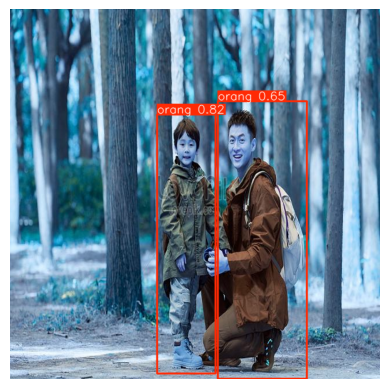

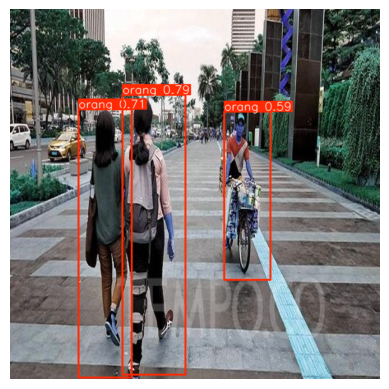

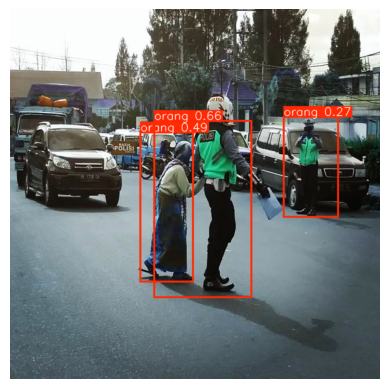

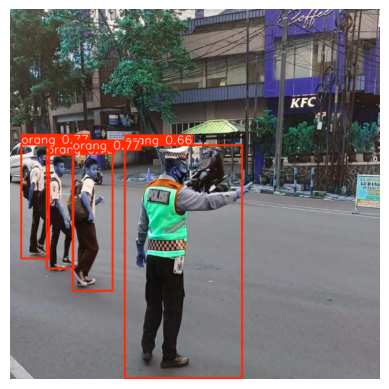

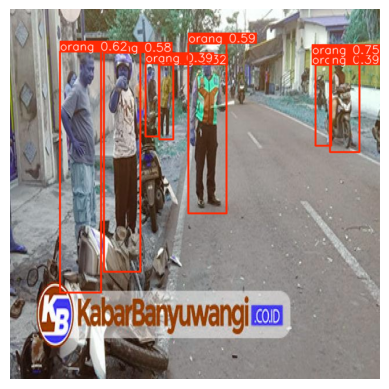

...

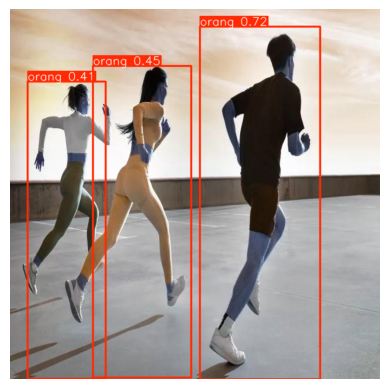

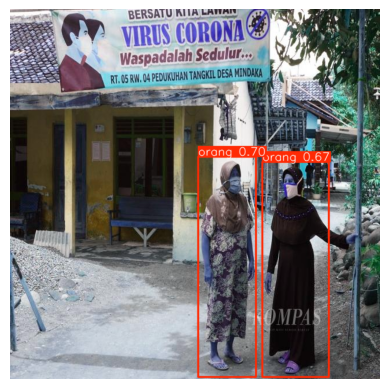

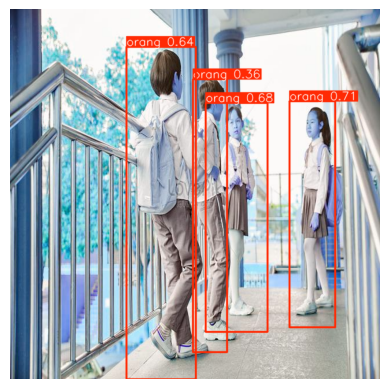

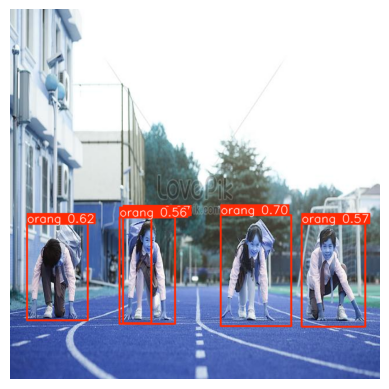

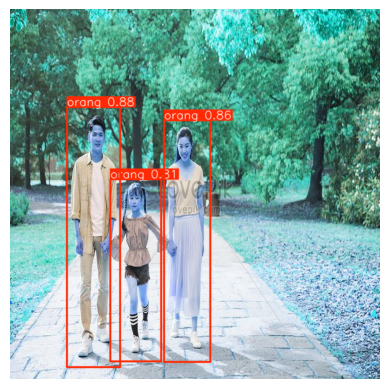

In [ ]:
# Menampilkan semua hasil prediksi
import matplotlib.pyplot as plt

# Loop melalui semua gambar hasil prediksi
for image_result in result:
    # Plot setiap hasil prediksi
    image_path_with_predictions = image_result.plot()  # Mengembalikan array gambar

    # Tampilkan menggunakan Matplotlib
    plt.imshow(image_path_with_predictions)
    plt.axis("off")
    plt.show()


In [ ]:
# Step 3: Upload image
uploaded = files.upload()
image_path = list(uploaded.keys())[0]

Saving 6071-jpg_wh860_jpg.rf.5ee294fc1d43cc0eef47d9a20c9749c9.jpg to 6071-jpg_wh860_jpg.rf.5ee294fc1d43cc0eef47d9a20c9749c9.jpg
Saving 836855_720_jpg.rf.8ab07db5b63e34d53b749f848119f9c2.jpg to 836855_720_jpg.rf.8ab07db5b63e34d53b749f848119f9c2.jpg
Saving benefit-1400x600px_webp.rf.992f9f8af54ca44d2f1ab64b2ce431a1.jpg to benefit-1400x600px_webp.rf.992f9f8af54ca44d2f1ab64b2ce431a1.jpg
Saving depositphotos_53760525-stock-photo-mom-teaches-son-to-cross_jpg.rf.bb788eb4c12e754ac13b628a51fc2993.jpg to depositphotos_53760525-stock-photo-mom-teaches-son-to-cross_jpg.rf.bb788eb4c12e754ac13b628a51fc2993.jpg
Saving depositphotos_80945468-stock-photo-children-crossing-street-on-crosswalk_jpg.rf.6ca35ba2793cb648db91c3471b027c71.jpg to depositphotos_80945468-stock-photo-children-crossing-street-on-crosswalk_jpg.rf.6ca35ba2793cb648db91c3471b027c71.jpg
Saving depositphotos_613994166-stock-photo-mother-four-kids-discovering-watching_jpg.rf.2c00c914f46a75d54968a348bf5bef65.jpg to depositphotos_613994166-

In [ ]:
# Step 4: Load YOLO model
model = YOLO('yolov8n.pt')  # Use a pre-trained YOLOv8 model (nano version for speed)

In [ ]:
# Step 5: Perform object detection
results = model(image_path)  # Run inference on the uploaded image


image 1/1 /content/6071-jpg_wh860_jpg.rf.5ee294fc1d43cc0eef47d9a20c9749c9.jpg: 640x640 2 persons, 216.8ms
Speed: 2.9ms preprocess, 216.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


In [ ]:
# Step 6: Visualize results
# Save the annotated image
annotated_img = results[0].plot()  # Create an annotated image (numpy array)

In [ ]:
cv2.imwrite("/content/runs/detect/train/F1_curve.png", annotated_img)

True

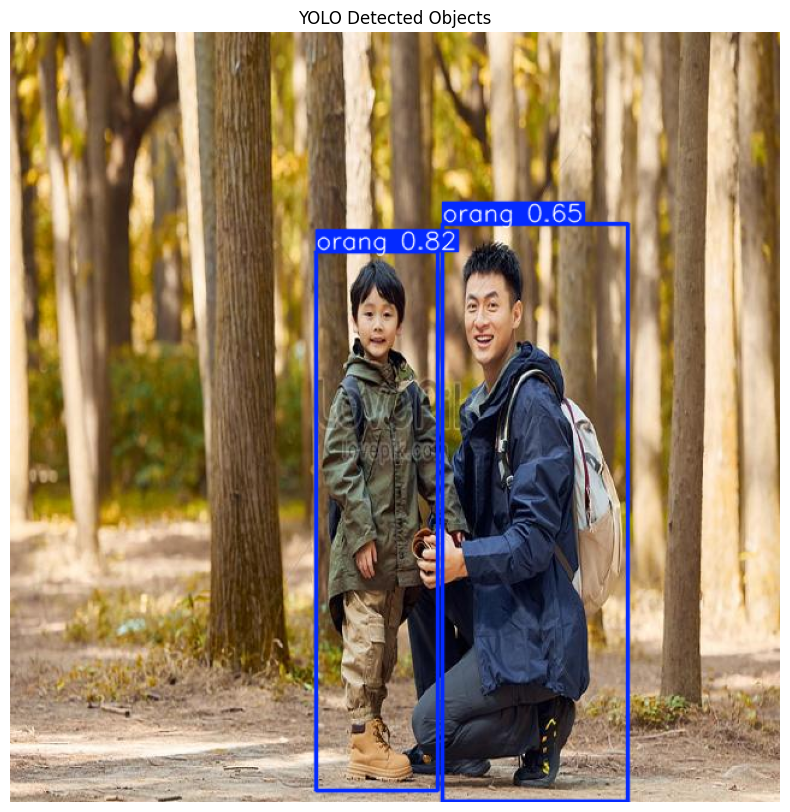

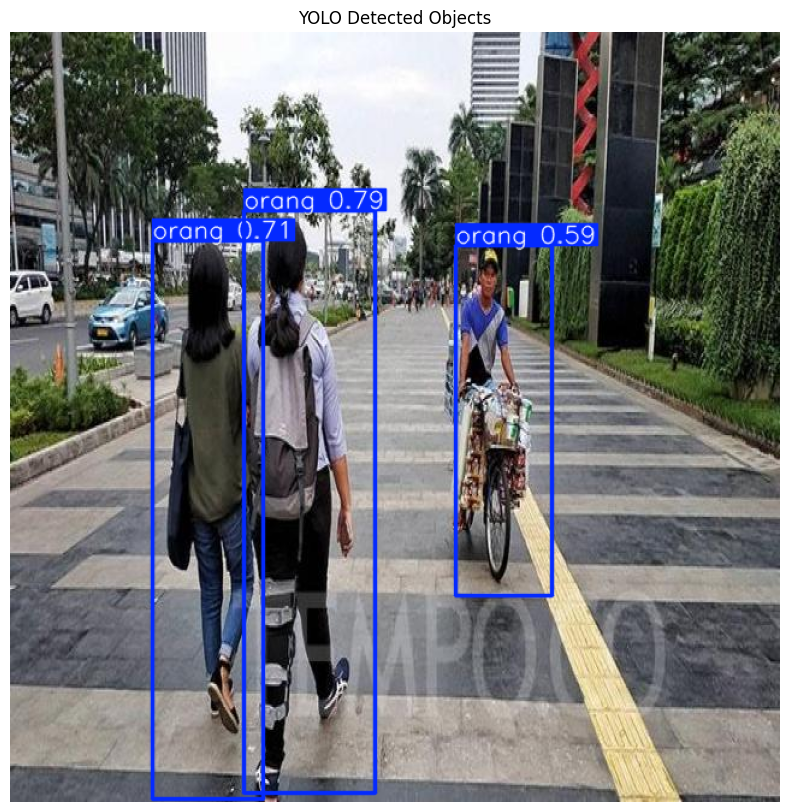

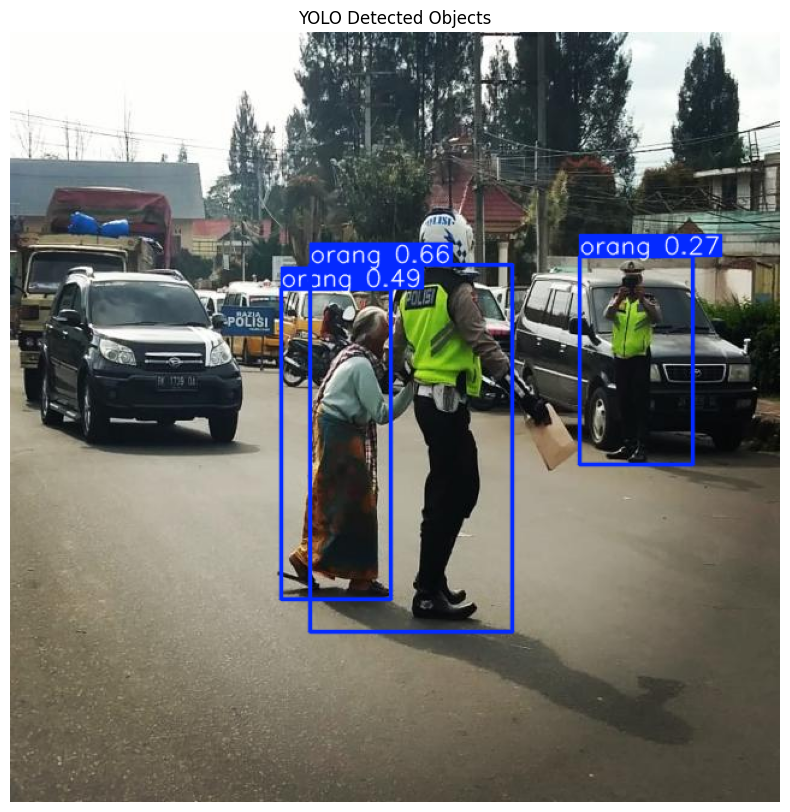

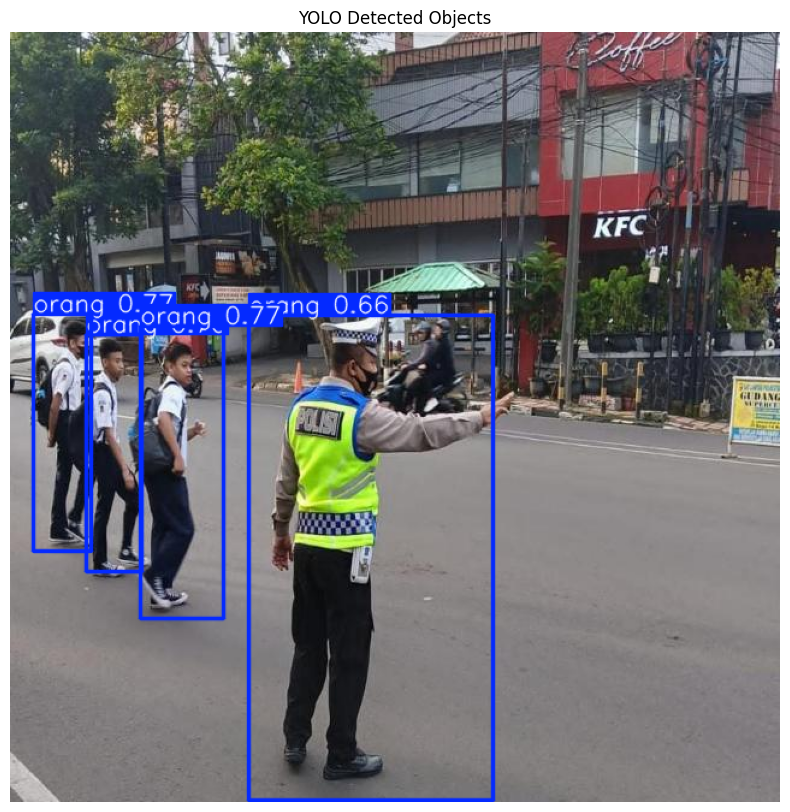

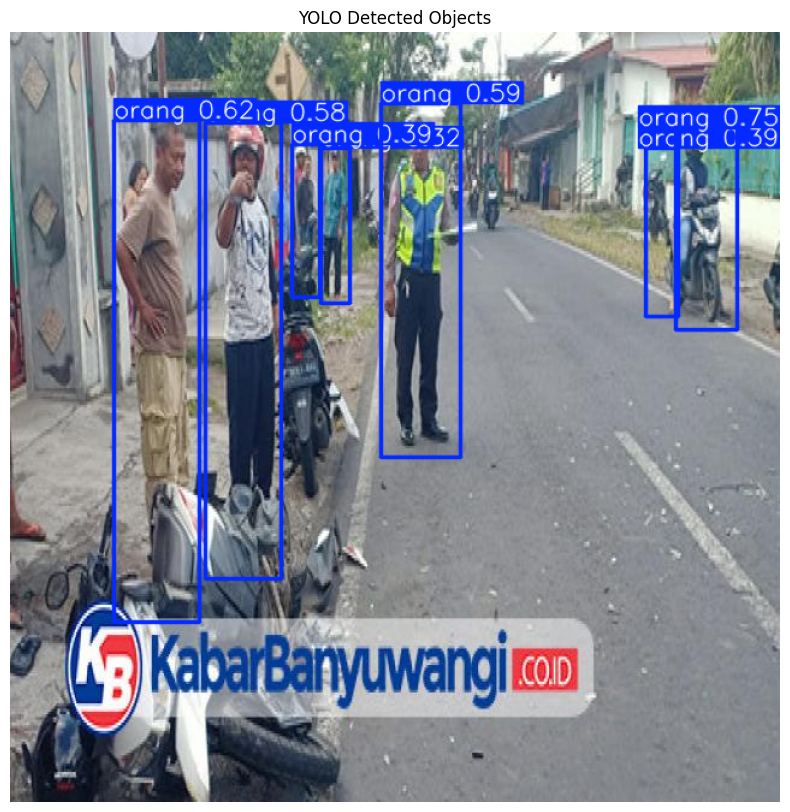

...

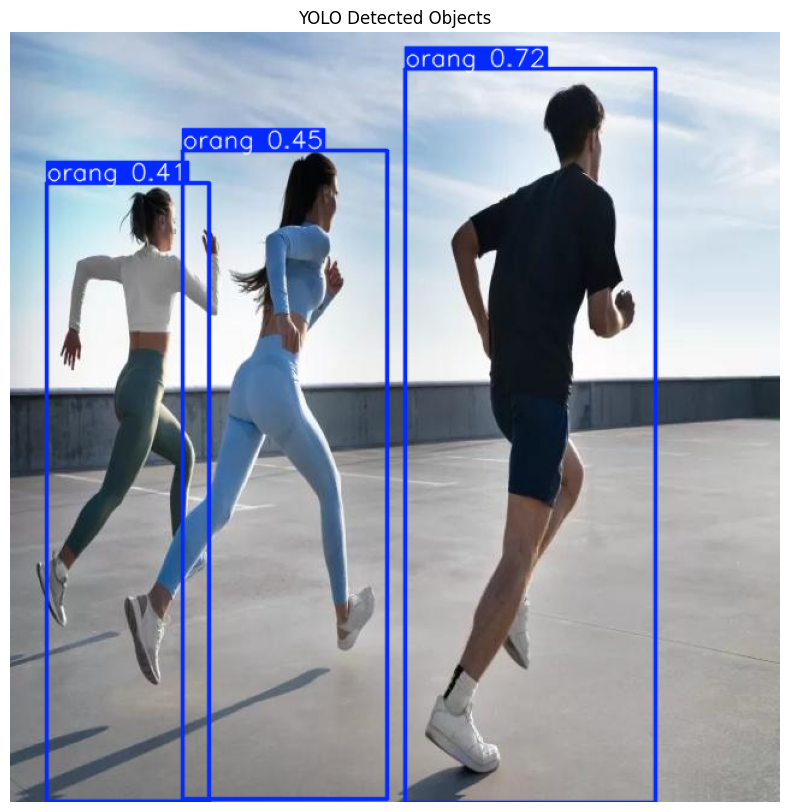

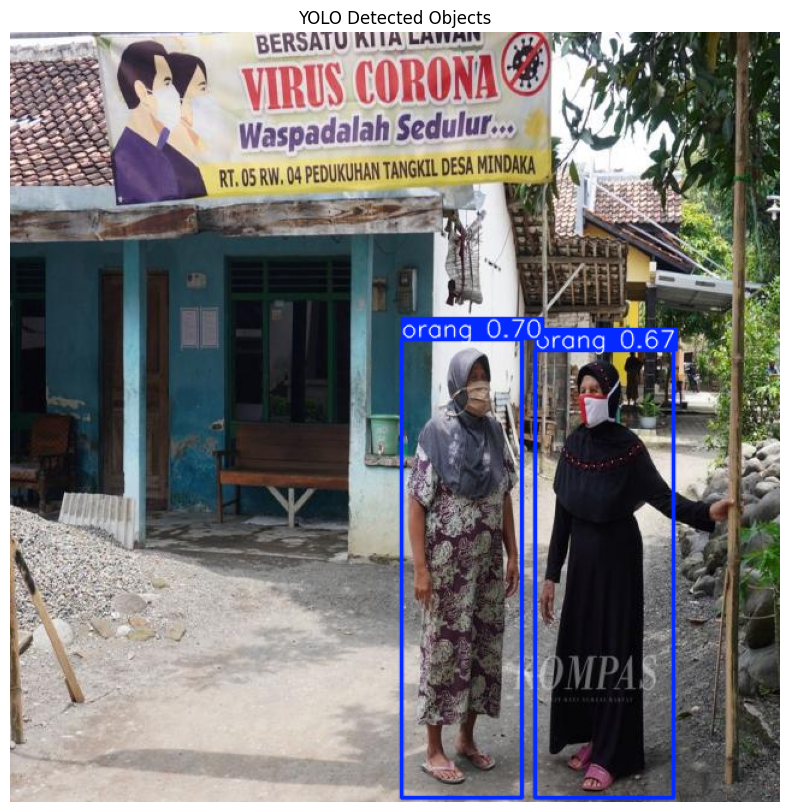

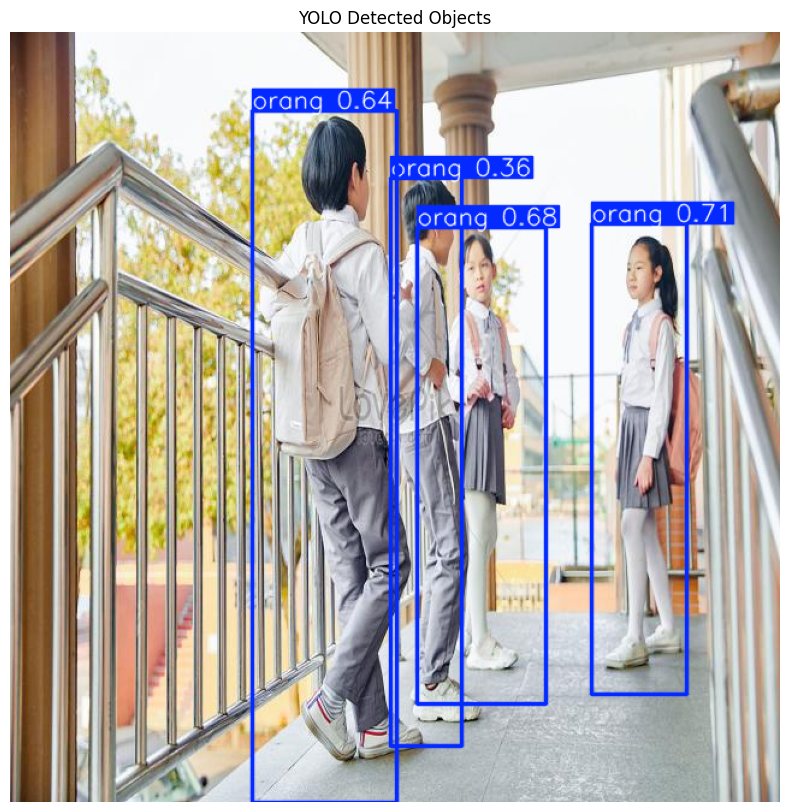

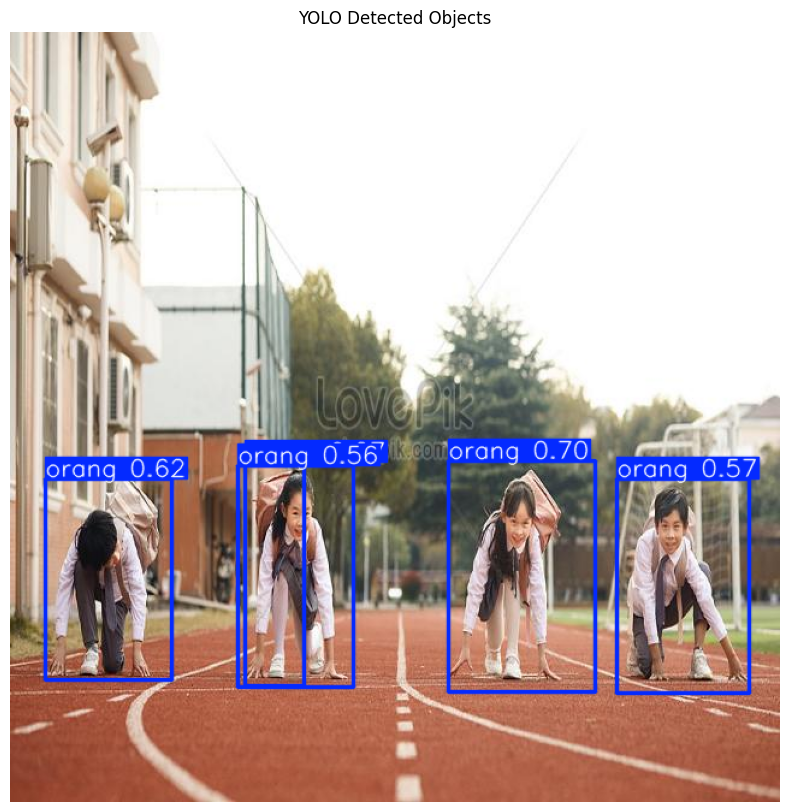

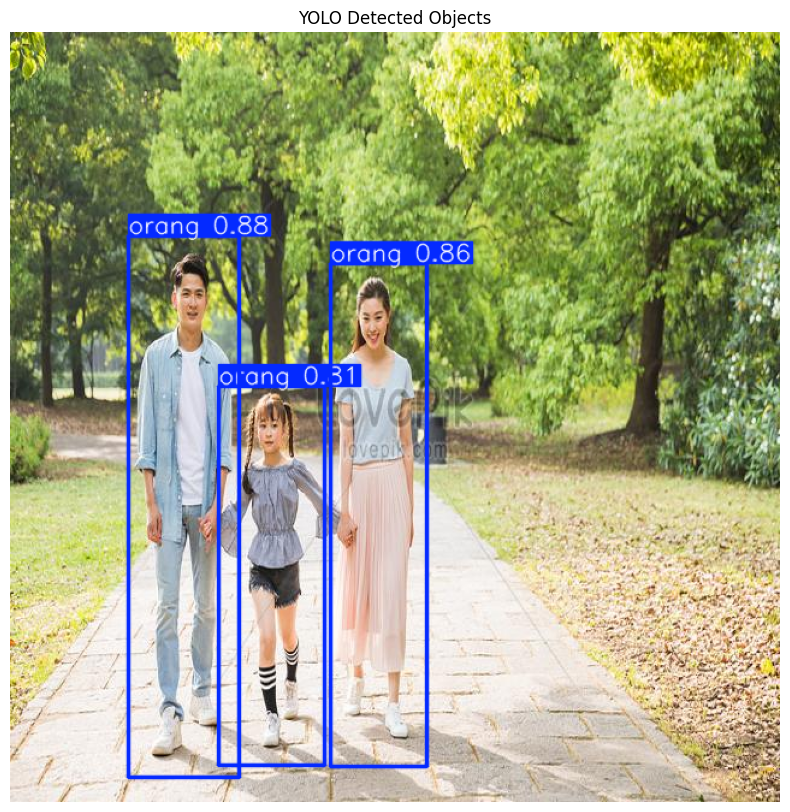

In [ ]:
import cv2
import matplotlib.pyplot as plt

# Loop melalui semua hasil prediksi
for image_result in result:
    # Ambil gambar yang sudah dianotasi
    annotated_img = image_result.plot()  # Mengembalikan array gambar dengan bounding box

    # Tampilkan gambar menggunakan Matplotlib
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(annotated_img, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("YOLO Detected Objects")
    plt.show()
